In [1]:
import fitsio as fio
import numpy as np
import healsparse
import h5py as h5
import glob
from tqdm import tqdm
from matplotlib import pyplot as plt
import proplot as pplt
import skyproj
%matplotlib inline

In [3]:
hmap = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6-combined-hleda-gaiafull-des-stars-hsmap131k-mdet-v1.hsp")
footprint_map = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6a2_decasu_griz_nexpgt2_and_fp2_footprint.hsp")
gold_mask_map = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6a2_foreground_mask_healsparse_nside16384.fits.gz")

# Mask viz

In [4]:
f = '/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/metadetect_desdmv5a_cutsv5_patchesv5b.h5'
mdet_data = h5.File(f, 'r')
d = mdet_data.get('/mdet/noshear')
ra = np.array(d['ra']); dec = np.array(d['dec'])

in_footprint = hmap.get_values_pos(ra, dec, valid_mask=True)
ra_removed = ra[~in_footprint]; dec_removed = dec[~in_footprint]; 

print(len(ra), len(ra_))

NameError: name 'ra_' is not defined

In [5]:
hmap_old = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6-combined-hleda-gaiafull-des-stars-hsmap16384-nomdet-v3.fits")
in_footprint = hmap_old.get_values_pos(ra, dec, valid_mask=True)
print(len(ra), len(ra[in_footprint]))

150093691 150093691


No handles with labels found to put in legend.
<ipython-input-7-bc4832c6ac9b>:15: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


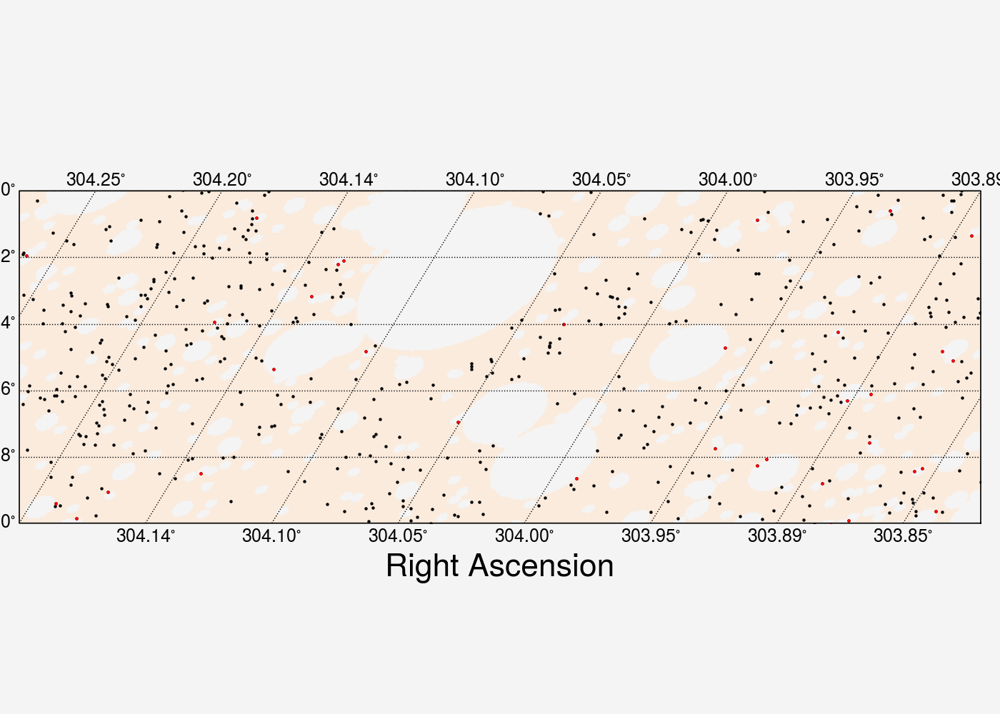

In [7]:
from matplotlib import pyplot as plt
import proplot as pplt
import skyproj
%matplotlib inline

fig,ax = plt.subplots(figsize=(7,5), nrows=1, ncols=1, sharey=False, sharex=False)
m = skyproj.McBrydeSkyproj(ax=ax, autorescale=False)
_ = m.draw_hspmap(hmap, cmap='rocket')

m.scatter(ra, dec, s=1, marker='o', c='k', zorder=20, label="All")
m.scatter(ra_removed, dec_removed, s=1, marker='o', c='r', zorder=20, label="Removed")
m.set_extent([303.9,304.2,-52.3,-52.2])
#m.set_extent([300,315,-56,-49])
ax.legend()
plt.tight_layout()

In [3]:
hmap_old = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6-combined-hleda-gaiafull-des-stars-hsmap16384-nomdet-v3.fits")
in_footprint = hmap_old.get_values_pos(ra, dec, valid_mask=True)
ra_ = ra[in_footprint]

print(len(ra), len(ra_))

150093691 150093691


In [4]:
footprint_map = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6a2_decasu_griz_nexpgt2_and_fp2_footprint.hsp")
gold_mask_map = healsparse.HealSparseMap.read("/global/cfs/cdirs/des/y6-shear-catalogs/y6a2_foreground_mask_healsparse_nside16384.fits.gz")

Text(0.5, 1.0, 'gold mask v1.4')

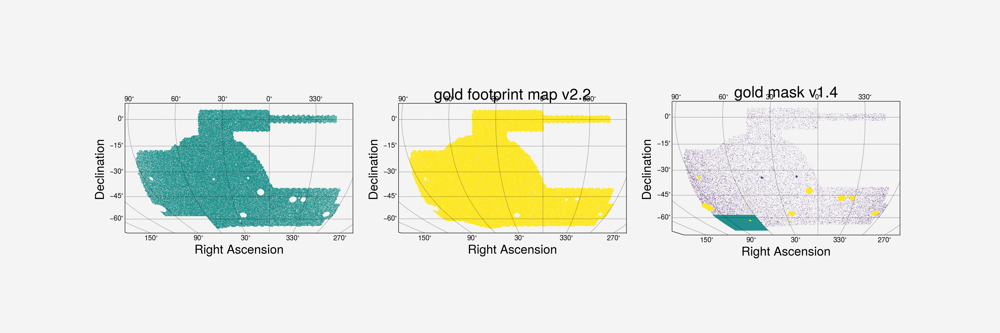

In [15]:
from matplotlib import pyplot as plt
import proplot as pplt
import skyproj
%matplotlib inline

fig,ax = plt.subplots(figsize=(18,6), nrows=1, ncols=3, sharey=False, sharex=False)
m = skyproj.McBrydeSkyproj(ax=ax[0], autorescale=False)
_ = m.draw_hspmap(hmap, cmap='viridis')

m = skyproj.McBrydeSkyproj(ax=ax[1], autorescale=False)
_ = m.draw_hspmap(footprint_map, cmap='viridis')
plt.title('gold footprint map v2.2', fontsize=20)

m = skyproj.McBrydeSkyproj(ax=ax[2])
_ = m.draw_hspmap(gold_mask_map, cmap='viridis')
plt.title('gold mask v1.4', fontsize=20)

In [10]:
# in gold footprint map
in_gold_footprint = footprint_map.get_values_pos(ra, dec, valid_mask=True)

# in gold mask 
in_gold_mask = gold_mask_map.get_values_pos(ra, dec, valid_mask=True)
ra_ = ra[(in_gold_footprint & ~in_gold_mask)]
print(len(ra_))

148645926


In [4]:
f_gold = fio.FITS('/pscratch/sd/m/myamamot/gold/all/gold_all_master.fits')
d_gold = f_gold[-1].read(columns=['RA', 'DEC', 'EXT_MASH'])
ra_gold = d_gold['RA']
dec_gold = d_gold['DEC']

print(len(ra_gold))
in_gold_footprint = footprint_map.get_values_pos(d_gold['RA'], d_gold['DEC'], valid_mask=True)
in_gold_mask = gold_mask_map.get_values_pos(d_gold['RA'], d_gold['DEC'], valid_mask=True)
ra_gold_ = ra_gold[in_gold_footprint & ~in_gold_mask]
print(len(ra_gold_))

573266798
559151056


# Vis unmatched sources

In [3]:
def apply_gold_mask(d, ra_col, dec_col):
    
    in_gold_footprint = footprint_map.get_values_pos(np.array(d[ra_col]), np.array(d[dec_col]), valid_mask=True)
    in_gold_mask = gold_mask_map.get_values_pos(np.array(d[ra_col]), np.array(d[dec_col]), valid_mask=True)
    msk = (in_gold_footprint & ~in_gold_mask)
    
    in_footprint = hmap.get_values_pos(np.array(d[ra_col]), np.array(d[dec_col]), valid_mask=True)
    msk &= in_footprint
    
    return msk

def apply_mask(d):
    
    from des_y6utils import mdet
    
    msk = (d["mdet_step"] == 'noshear')
    
    in_gold_footprint = footprint_map.get_values_pos(d["ra"], d["dec"], valid_mask=True)
    in_gold_mask = gold_mask_map.get_values_pos(d["ra"], d["dec"], valid_mask=True)
    msk_mask = (in_gold_footprint & ~in_gold_mask)
    msk &= msk_mask
    
    
    in_footprint = hmap.get_values_pos(d["ra"], d["dec"], valid_mask=True)
    msk &= in_footprint
    
    n_terr = 0
    msk &= (d["gauss_T_ratio"] >= np.maximum(
            0.5,
            (n_terr*d["gauss_T_err"]/d["gauss_psf_T"])))
    
    min_s2n = 10
    max_s2n = np.inf
    max_size = np.inf # change to 20 for the final version
    msk &= ((d["gauss_s2n"] > min_s2n)
            & (d["gauss_s2n"] < max_s2n)
            & ((d["gauss_T_ratio"] * d["gauss_psf_T"]) < max_size)) 
    
    mag_g = mdet._compute_asinh_mags(d["pgauss_band_flux_g"], 0)
    mag_r = mdet._compute_asinh_mags(d["pgauss_band_flux_r"], 1)
    mag_i = mdet._compute_asinh_mags(d["pgauss_band_flux_i"], 2)
    mag_z = mdet._compute_asinh_mags(d["pgauss_band_flux_z"], 3)
    gmr = mag_g - mag_r
    rmi = mag_r - mag_i
    imz = mag_i - mag_z
    
    msk &= ((np.abs(gmr) < 5)
            & (np.abs(rmi) < 5)
            & (np.abs(imz) < 5)
            & np.isfinite(mag_g)
            & np.isfinite(mag_r)
            & np.isfinite(mag_i)
            & np.isfinite(mag_z)
            & (mag_g < 26.5)
            & (mag_r < 26.5)
            & (mag_i < 26.2) # add 24.5 for the final version
            & (mag_z < 25.6)
            & (d["mfrac"] < 0.1))
   
    msk &= (d["pgauss_T"] < (1.2 - 3.1*d["pgauss_T_err"])) # change 1.6-3.1*x for the final version
    size_sizeerr = (d['gauss_T_ratio']*d['gauss_psf_T']) * d['gauss_T_err']
    size_s2n = (d['gauss_T_ratio']*d['gauss_psf_T']) / d['gauss_T_err']
    msk_superspreader = ((size_sizeerr > 1) & (size_s2n < 10))
    msk &= ~msk_superspreader
    
    
    
    return msk

In [4]:
f_gold = fio.FITS('/pscratch/sd/m/myamamot/gold/all/gold_all_master.fits')
d_gold = f_gold[-1].read(columns=['RA', 'DEC', 'EXT_MASH'])
msk_gold = apply_gold_mask(d_gold)
d_gold = d_gold[msk_gold]

ValueError: no field of name ra

In [ ]:

mdet_f = sorted(glob.glob('/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/jackknife_patches_blinded/patch-*.fits'))
match_idx_f = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/mask+sg+s2nsize+flux+junk/mdety6_goldy6_matched_idx_*.npy'))
match_d2d_f = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/mask+sg+s2nsize+flux+junk/mdety6_goldy6_matched_d2d_*.npy'))
print(mdet_f[0], match_idx_f[0])
for j in tqdm(range(1)):
    d_y6 = fio.read(mdet_f[j])
    
    msk_d = apply_mask(d_y6)
    d_y6 = d_y6[msk_d]
    
    idx=np.load(match_idx_f[j])
    d2d=np.load(match_d2d_f[j]) * 3600
    # num_tot += len(idx)
    print(len(idx), len(d_y6))
    
    msk_sep = d2d>(0.263)
    # match_mdet += len(idx[msk])
    # matched_gold = d_gold[idx[msk]]
    
    # unmatched
    idx_gold = idx[msk_sep]
    ra_gold = d_gold['RA'][idx_gold]
    dec_gold = d_gold['DEC'][idx_gold]
    ra_unmatch = d_y6['ra'][msk_sep]
    dec_unmatch = d_y6['dec'][msk_sep]

    print(len(ra_unmatch), len(ra_gold))

Text(0.5, 0, 'matched distance [arcsec]')

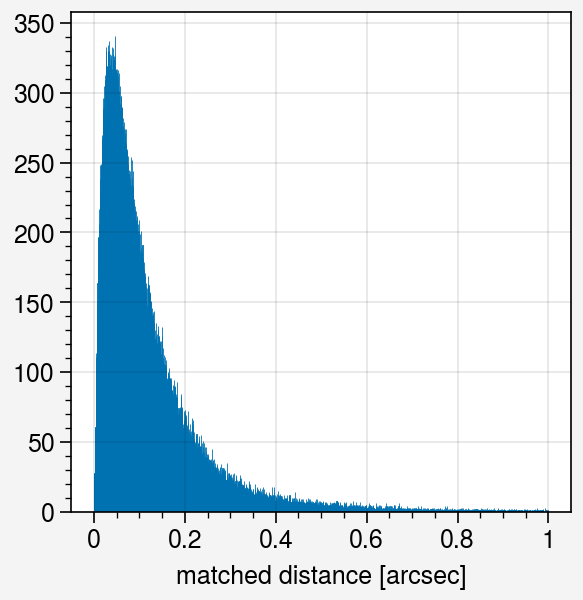

In [8]:
fig,ax=pplt.subplots()
ax.hist(d2d,  bins=10000, range=[1e-5, 1])
ax.set_xlabel('matched distance [arcsec]', )

64803 64803


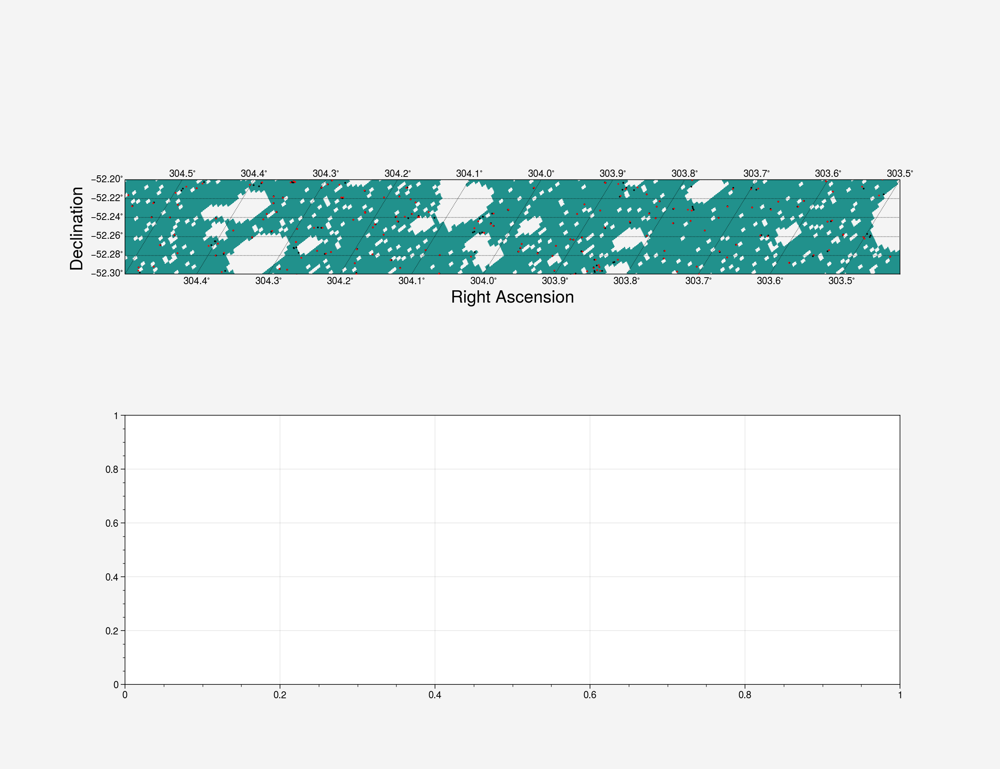

In [7]:
print(len(ra_unmatch), len(ra_gold))
fig,ax = plt.subplots(figsize=(13,10), nrows=2, ncols=1, sharey=False, sharex=False)
m = skyproj.McBrydeSkyproj(ax=ax[0], autorescale=False)
_ = m.draw_hspmap(hmap, cmap='viridis')

m.scatter(ra_unmatch, dec_unmatch, s=1, marker='o', c='k', zorder=20)
m.scatter(ra_gold, dec_gold, s=1, marker='o', c='r', zorder=20)
m.set_extent([303.5,304.5,-52.3,-52.2])
#m.set_extent([300,315,-56,-49])

# m = skyproj.McBrydeSkyproj(ax=ax[1], autorescale=False)
# _ = m.draw_hspmap(hmap_mdetmask, cmap='viridis')

# m.scatter(ra_unmatch, dec_unmatch, s=1, marker='o', c='k', zorder=20)
# m.scatter(ra_gold, dec_gold, s=1, marker='o', c='r', zorder=20)
# m.set_extent([303,305,-52.5,-52.0])

# plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/gold_match_shearmask.pdf', bbox_inches='tight')

In [3]:
import numpy as np
from matplotlib import pyplot as plt
import matplotlib
import glob
import os,sys
import fitsio as fio
import matplotlib as mpl
from tqdm import tqdm
import proplot as pplt
import pickle
import pandas as pd
from des_y6utils import viz
from matplotlib.colors import LogNorm
%matplotlib inline

from astropy.visualization import LinearStretch, LogStretch
from astropy.visualization import ZScaleInterval, MinMaxInterval
from astropy.visualization import ImageNormalize
from astropy.io.fits import getdata

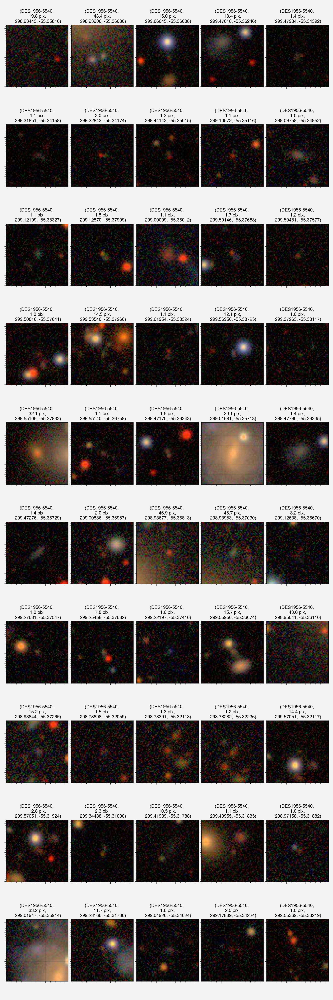

In [14]:
tile_start = 0
fs = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/data/v5_gold_match/*.fits'))
layout = np.arange(50).reshape(10, 5)
fig,ax = plt.subplot_mosaic(layout, figsize=(10,30))
n = None

for i,filename in enumerate(fs):
    tilename = filename.split('/')[-1].split('_')[0]
    j = int(filename.split('_')[-1].split('.')[0][3:])
    sep = d2d[msk_sep][j]/0.263
    raobj = ra_unmatch[j]
    decobj = dec_unmatch[j]
    dgri = fio.read(filename)

    norm = ImageNormalize(dgri, interval=ZScaleInterval(), stretch=LinearStretch())
    ax[i].imshow(dgri, norm=norm, origin='lower')
    ax[i].set_xticklabels([])
    ax[i].set_yticklabels([])
    ax[i].set_title('(%s, \n %.1f pix, \n %.5f, %.5f)' % (tilename, sep, raobj, decobj)) #'%.2f' % sep, '%.5f' % raobj, '%.5f' % decobj)
    
    if i == 49:
        break

plt.tight_layout()
plt.subplots_adjust(wspace=0.05, hspace=0.1)
plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/v5b_gold_match.png', bbox_inches='tight')

In [158]:
f = h5.File('/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/metadetect_desdmv5a_cutsv5_patchesv5b.h5', 'r')
d_y6_h5 = f.get('/mdet/noshear')
msk = apply_gold_mask(d_y6_h5, 'ra', 'dec')
print(len(np.array(d_y6_h5['ra'])[msk]))
# tname = np.array(d_y6_h5['patch_num'])
# x = np.array(d_y6_h5['x'])[tname == 0]
# y = np.array(d_y6_h5['y'])[tname == 0]

140021309


In [141]:
# mdet_f = sorted(glob.glob('/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/jackknife_patches_blinded/patch-*.fits'))
mdet_f = '/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/tiles_blinded/DES1956-5540_metadetect-v10_mdetcat_part0000.fits'
d_y6 = fio.read(mdet_f)

match_hleda = False
if match_hleda:
    from astropy.coordinates import SkyCoord
    from astropy import units as uu
    dh = fio.read('/global/cfs/cdirs/des/y6-shear-catalogs/hyperleda_B16_18.fits.gz', lower=True)
    ra_y6 = np.array(d_y6['ra'])
    dec_y6 = np.array(d_y6['dec'])
    cat1 = SkyCoord(ra=ra_y6*uu.degree, dec=dec_y6*uu.degree)
    cat2 = SkyCoord(ra=dh['ra']*uu.degree, dec=dh['dec']*uu.degree)
    idx, d2d, d3d = cat1.match_to_catalog_sky(cat2, nthneighbor=1)
    np.save('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/DES1956-5540_hleda_matched_idx.npy', idx)
    np.save('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/DES1956-5540_hleda_matched_d2d.npy', d2d.deg)

msk = apply_mask(d_y6)
d_y6 = d_y6[msk]

msk_tile = ((d_y6['tilename'] == 'DES1956-5540') & (d_y6['ra'] > 299.4) & (d_y6['ra'] <  299.6) & (d_y6['dec'] > -55.5) & (d_y6['dec'] < -55.4))

/global/homes/m/myamamot/miniforge3/envs/eastlake-dev/lib/python3.8/site-packages/PIL/Image.py:2832: DecompressionBombWarning: Image size (100000000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


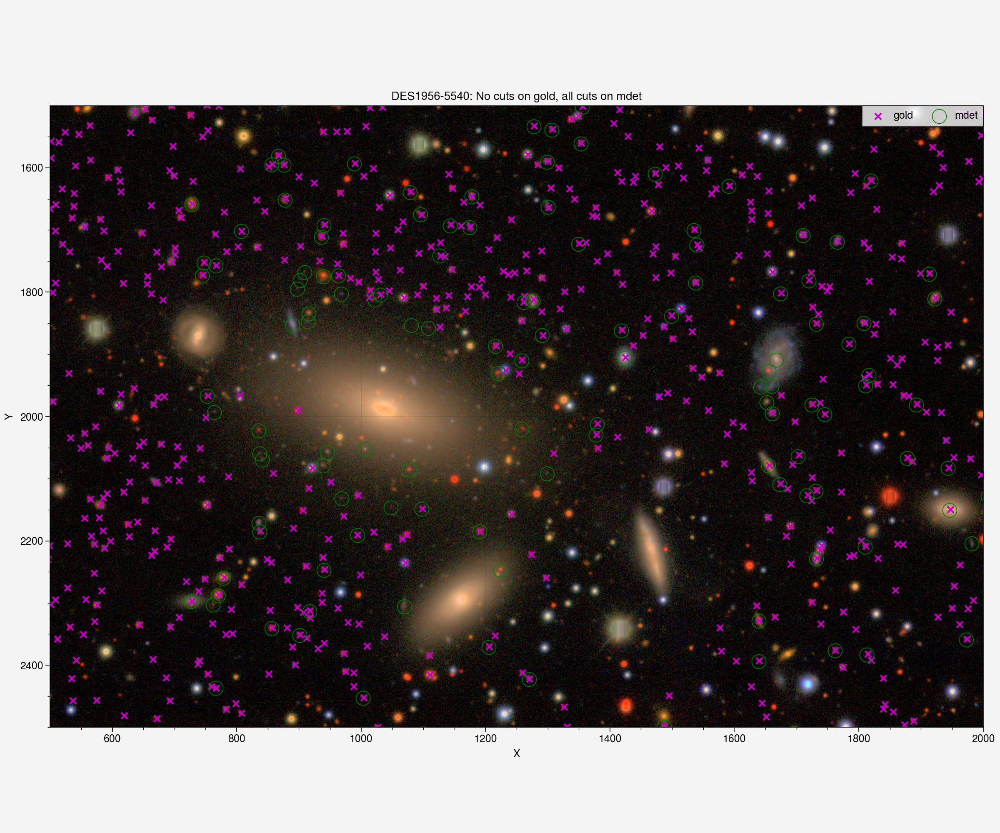

In [143]:
gold_tmp = fio.read('~/DES1956-5540_GOLD.fits')
hleda = fio.read('/global/cfs/cdirs/des/y6-shear-catalogs/hyperleda_B16_18.fits.gz')
msk_gold = apply_gold_mask(gold_tmp)
gold_tmp = gold_tmp[msk_gold]
im = plt.imread(f"""/pscratch/sd/m/myamamot/des-y6-analysis/data/color_images/DES1956-5540-gri.jpg""", format='jpg')

fig,ax=pplt.subplots(figsize=(12,10))
norm = ImageNormalize(im, interval=ZScaleInterval(), stretch=LinearStretch())
ax.imshow(im, norm=norm)
ax.scatter(gold_tmp['XWIN_IMAGE'], 10000-gold_tmp['YWIN_IMAGE'], marker='x', c='m', s=30, label='gold')
ax.scatter(d_y6[msk_tile]['x'], 10000-d_y6[msk_tile]['y'], edgecolors='g', facecolors='none', s=150 ,label='mdet')
# ax.set_xlim(5000,5700)
# ax.set_ylim(10000-9000, 10000-9500)
ax.set_xlim(500,2000)
ax.set_ylim(10000-7500, 10000-8500)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('DES1956-5540: No cuts on gold, all cuts on mdet')
ax.legend(loc='upper right')
# plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/DES1956-5540_gold_mdet_all_noshear_goldnocuts_mdetallcuts.png')

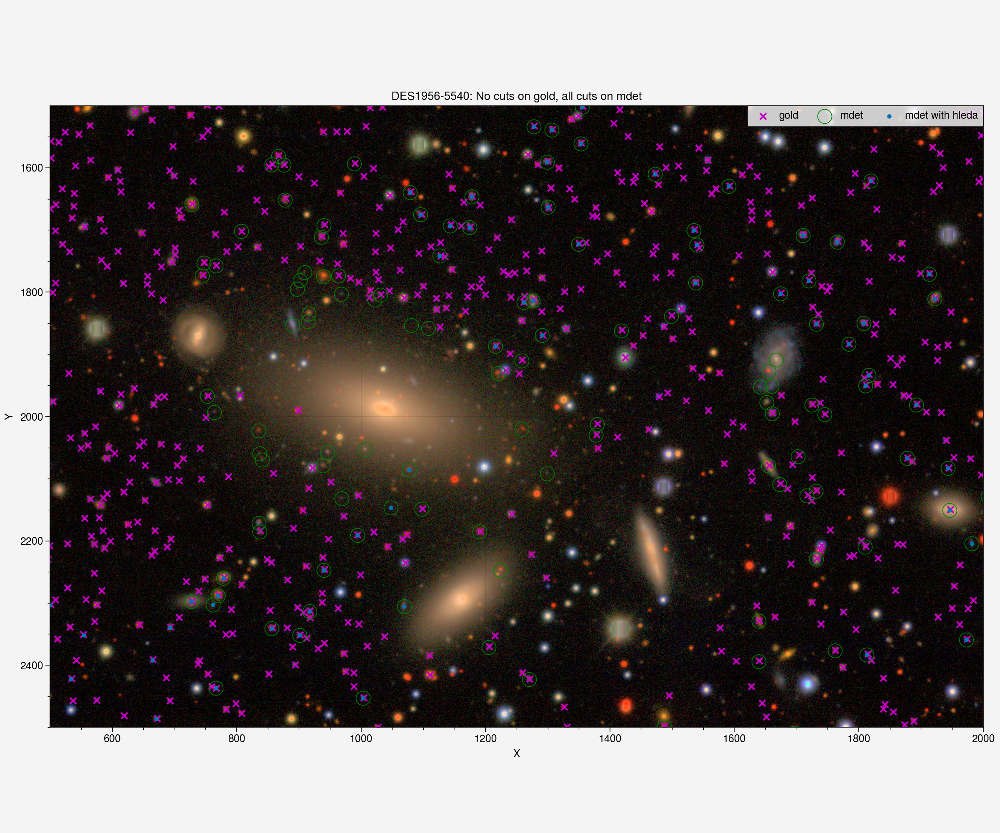

In [152]:
idx_hleda = np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/DES1956-5540_hleda_matched_idx.npy')
d2d_hleda = np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/DES1956-5540_hleda_matched_d2d.npy') * 3600
msk_hleda = d2d_hleda[msk] > 100

fig,ax=pplt.subplots(figsize=(12,10))
norm = ImageNormalize(im, interval=ZScaleInterval(), stretch=LinearStretch())
ax.imshow(im, norm=norm)
ax.scatter(gold_tmp['XWIN_IMAGE'], 10000-gold_tmp['YWIN_IMAGE'], marker='x', c='m', s=30, label='gold')
ax.scatter(d_y6[msk_tile]['x'], 10000-d_y6[msk_tile]['y'], edgecolors='g', facecolors='none', s=150 ,label='mdet')
ax.scatter(d_y6[msk_hleda]['x'], 10000-d_y6[msk_hleda]['y'], s=10 ,label='mdet with hleda')
# ax.set_xlim(5000,5700)
# ax.set_ylim(10000-9000, 10000-9500)
ax.set_xlim(500,2000)
ax.set_ylim(10000-7500, 10000-8500)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('DES1956-5540: No cuts on gold, all cuts on mdet')
ax.legend(loc='upper right')
# plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/DES1956-5540_gold_mdet_all_noshear_goldnocuts_mdetallcuts.png')

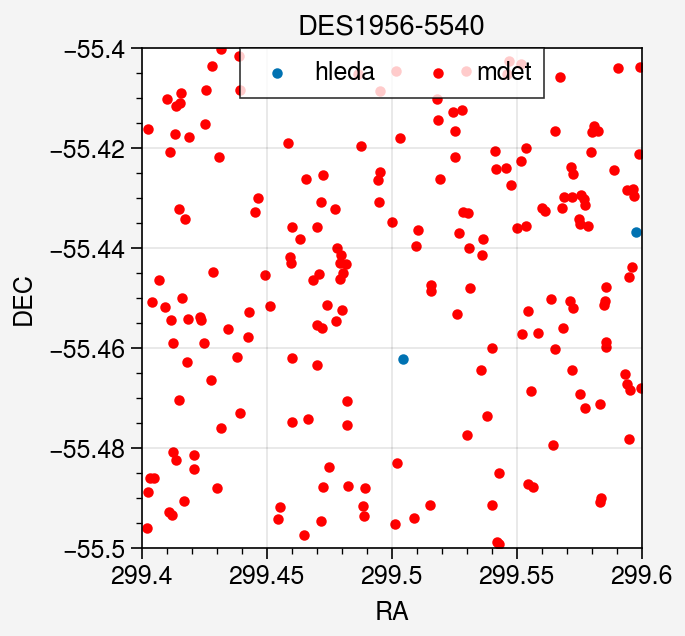

In [144]:
fig,ax=pplt.subplots()
ax.scatter(hleda['ra'], hleda['dec'],s=10, label='hleda')
ax.scatter(d_y6[msk_tile]['ra'], d_y6[msk_tile]['dec'],c='r',s=10 ,label='mdet')
ax.set_xlim(299.4, 299.6)
ax.set_ylim(-55.5, -55.4)
ax.set_xlabel('RA')
ax.set_ylabel('DEC')
ax.set_title('DES1956-5540')
ax.legend()

  0%|          | 0/100 [00:00<?, ?it/s]

140021309 140021309


100%|██████████| 100/100 [00:40<00:00,  2.47it/s]


Text(0, 0.5, 'match rate between gold and mdet')

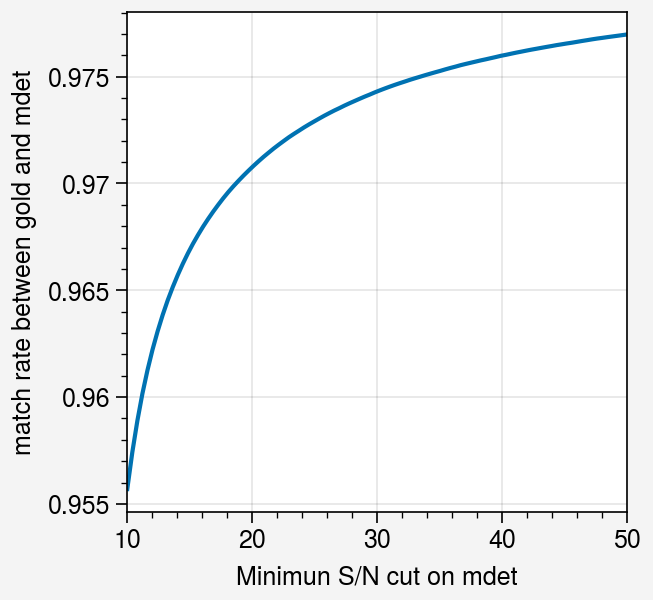

In [163]:
idx=np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/gold_allcuts_shear_allcuts/mdety6_goldy6_matched_idx.npy')
d2d=np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/gold_allcuts_shear_allcuts/mdety6_goldy6_matched_d2d.npy') * 3600

s2n = np.array(d_y6_h5['gauss_s2n'])[msk]
print(len(d2d), len(s2n))

mins2n = np.linspace(10, 50, 100)
match_rate = []
for r in tqdm(mins2n):
    msk_combined_mins2n = ((d2d<0.526) & (s2n>r))
    rate = np.sum(msk_combined_mins2n)/np.sum(s2n>r)
    match_rate.append(rate)

fig,ax=pplt.subplots()
ax.plot(mins2n, match_rate)
ax.set_xlabel('Minimun S/N cut on mdet', )
ax.set_ylabel('match rate between gold and mdet')

100%|██████████| 100/100 [00:16<00:00,  5.89it/s]


Text(0, 0.5, 'match rate between gold and mdet')

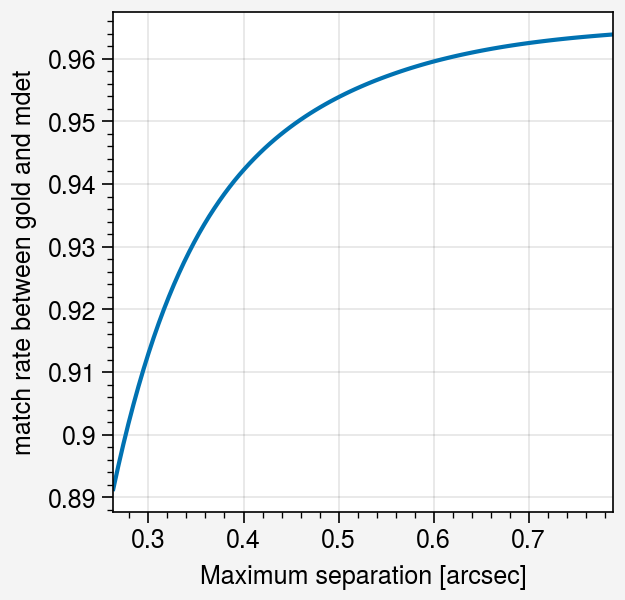

In [166]:
minsep = np.linspace(0.263, 0.789, 100)
match_rate = []
for r in tqdm(minsep):
    # msk_combined_minsep = ((d2d<r
    # rate = np.sum(msk_combined_mins2n)/np.sum(s2n>r)
    rate = np.mean(d2d < r)
    match_rate.append(rate)

fig,ax=pplt.subplots()
ax.plot(minsep, match_rate)
ax.set_xlabel('Maximum separation [arcsec]', )
ax.set_ylabel('match rate between gold and mdet')

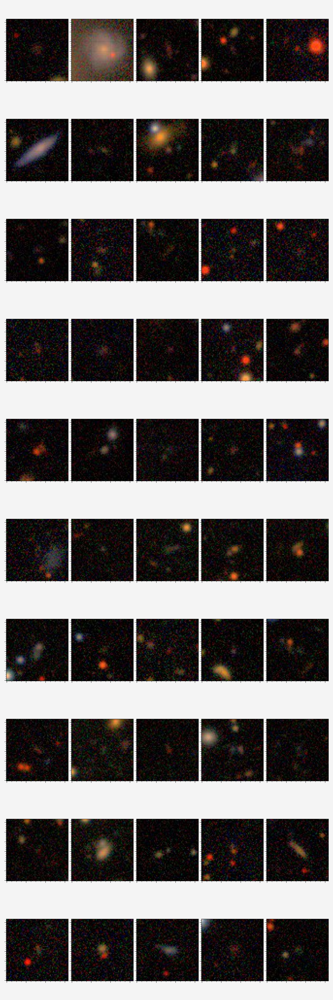

In [169]:
# Check the image of objects that don't match within 1 pixel but does match within 2 pixels.
tile_start = 0
fs = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/data/v5_gold_match_2pix/*.fits'))
layout = np.arange(50).reshape(10, 5)
fig,ax = plt.subplot_mosaic(layout, figsize=(10,30))
n = None

for i,filename in enumerate(fs):
    tilename = filename.split('/')[-1].split('_')[0]
    j = int(filename.split('_')[-1].split('.')[0][3:])
    # sep = d2d[msk_sep][j]/0.263
    # raobj = ra_unmatch[j]
    # decobj = dec_unmatch[j]
    dgri = fio.read(filename)

    norm = ImageNormalize(dgri, interval=ZScaleInterval(), stretch=LinearStretch())
    ax[i].imshow(dgri, norm=norm, origin='lower')
    ax[i].set_xticklabels([])
    ax[i].set_yticklabels([])
    # ax[i].set_title('(%s, \n %.1f pix, \n %.5f, %.5f)' % (tilename, sep, raobj, decobj)) #'%.2f' % sep, '%.5f' % raobj, '%.5f' % decobj)
    
    if i == 49:
        break

plt.tight_layout()
plt.subplots_adjust(wspace=0.05, hspace=0.1)
plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/v5b_gold_match_2pix.png', bbox_inches='tight')

In [4]:
# measure match distance as a function of reconv PSF FWHM
idx=np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/gold_allcuts_shear_allcuts/mdety6_goldy6_matched_idx.npy')
d2d=np.load('/pscratch/sd/m/myamamot/des-y6-analysis/y6_measurement/v5b_paper/goldmatch/gold_allcuts_shear_allcuts/mdety6_goldy6_matched_d2d.npy') * 3600

f = h5.File('/global/cfs/cdirs/des/y6-shear-catalogs/Y6A2_METADETECT_V5b/metadetect_desdmv5a_cutsv5_patchesv5b.h5', 'r')
d_y6_h5 = f.get('/mdet/noshear')
msk = apply_gold_mask(d_y6_h5, 'ra', 'dec')

140021309 140021309


Text(0, 0.5, 'matched distance')

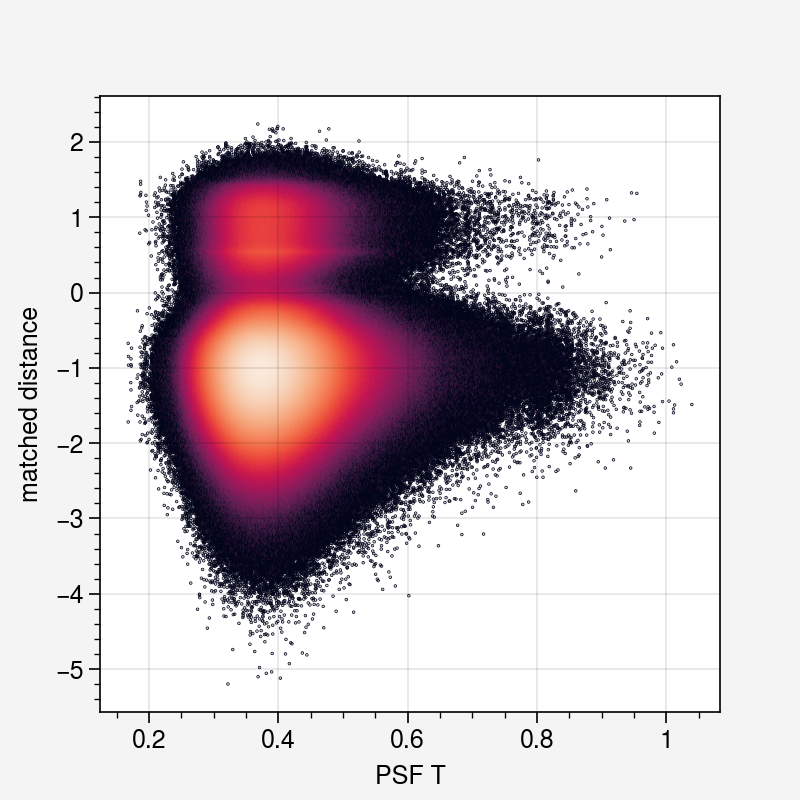

In [177]:
psfT = np.array(d_y6_h5['psfrec_T'])[msk]
print(len(d2d), len(psfT))

fig,ax=plt.subplots()
ax.hexbin(psfT, np.log10(d2d), bins='log', cmap='rocket', gridsize=1000, mincnt=0.000000001)
ax.set_xlabel('PSF T', )
ax.set_ylabel('matched distance [arcsec]')

In [ ]:
s2n = np.array(d_y6_h5['gauss_s2n'])[msk]
fig,ax=plt.subplots()
ax.hexbin(s2n, d2d, bins='log', xscale='log', yscale='log', cmap='rocket', gridsize=100000, mincnt=0.000000001)
ax.set_xlabel('S/N', )
ax.set_ylabel('matched distance [arcsec]')
plt.tight_layout()

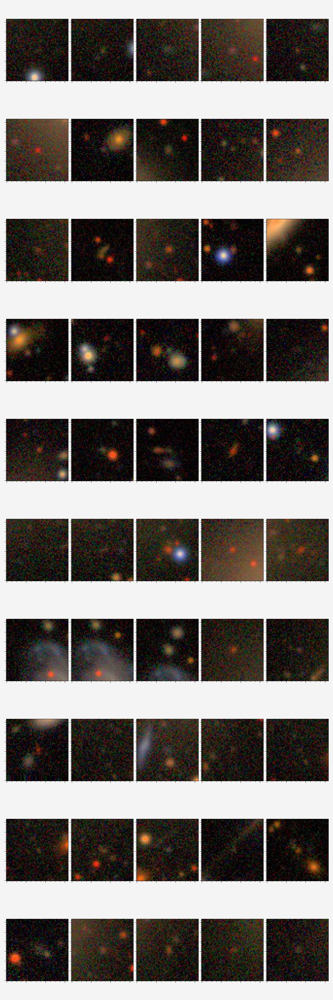

In [5]:
# plot objects in upper cloud (match dist > 1 AND s/n<100)
tile_start = 0
fs = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/data/v5_gold_match_match1arcsec_s2n100/*.fits'))
layout = np.arange(50).reshape(10, 5)
fig,ax = plt.subplot_mosaic(layout, figsize=(10,30))
n = None

for i,filename in enumerate(fs):
    tilename = filename.split('/')[-1].split('_')[0]
    j = int(filename.split('_')[-1].split('.')[0][3:])
    # sep = d2d[msk_sep][j]/0.263
    # raobj = ra_unmatch[j]
    # decobj = dec_unmatch[j]
    dgri = fio.read(filename)

    norm = ImageNormalize(dgri, interval=ZScaleInterval(), stretch=LinearStretch())
    ax[i].imshow(dgri, norm=norm, origin='lower')
    ax[i].set_xticklabels([])
    ax[i].set_yticklabels([])
    # ax[i].set_title('(%s, \n %.1f pix, \n %.5f, %.5f)' % (tilename, sep, raobj, decobj)) #'%.2f' % sep, '%.5f' % raobj, '%.5f' % decobj)
    
    if i == 49:
        break

plt.tight_layout()
plt.subplots_adjust(wspace=0.05, hspace=0.1)
plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/v5b_gold_match_1arcsec_s2n100.png', bbox_inches='tight')

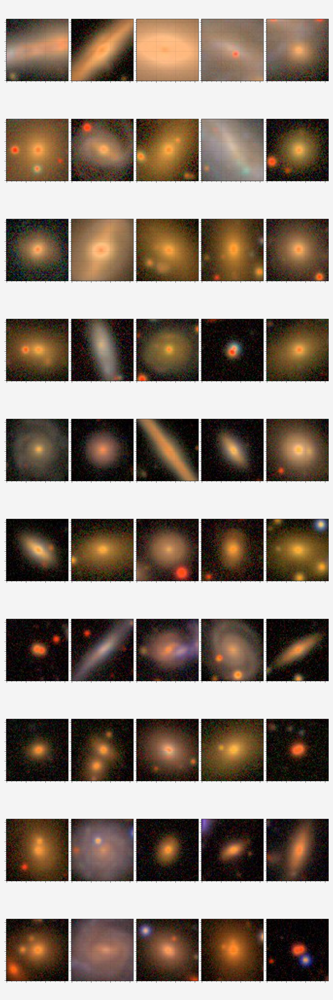

In [7]:
# plot objects in upper cloud (match dist > 1 AND s/n>1000)
tile_start = 0
fs = sorted(glob.glob('/pscratch/sd/m/myamamot/des-y6-analysis/data/v5_gold_match_match1arcsec_s2n1000/*.fits'))
layout = np.arange(50).reshape(10, 5)
fig,ax = plt.subplot_mosaic(layout, figsize=(10,30))
n = None

for i,filename in enumerate(fs):
    tilename = filename.split('/')[-1].split('_')[0]
    j = int(filename.split('_')[-1].split('.')[0][3:])
    # sep = d2d[msk_sep][j]/0.263
    # raobj = ra_unmatch[j]
    # decobj = dec_unmatch[j]
    dgri = fio.read(filename)

    norm = ImageNormalize(dgri, interval=ZScaleInterval(), stretch=LinearStretch())
    ax[i].imshow(dgri, norm=norm, origin='lower')
    ax[i].set_xticklabels([])
    ax[i].set_yticklabels([])
    # ax[i].set_title('(%s, \n %.1f pix, \n %.5f, %.5f)' % (tilename, sep, raobj, decobj)) #'%.2f' % sep, '%.5f' % raobj, '%.5f' % decobj)
    
    if i == 49:
        break

plt.tight_layout()
plt.subplots_adjust(wspace=0.05, hspace=0.1)
plt.savefig('/global/homes/m/myamamot/DES/des-y6-analysis/vf_figures/final_paper/v5b_gold_match_1arcsec_s2n1000.png', bbox_inches='tight')